<a href="https://www.kaggle.com/code/hsw1212/unet-binary-classification?scriptVersionId=142194273" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/carvana-image-masking-challenge/train_masks.zip
/kaggle/input/carvana-image-masking-challenge/29bb3ece3180_11.jpg
/kaggle/input/carvana-image-masking-challenge/train_masks.csv.zip
/kaggle/input/carvana-image-masking-challenge/train.zip
/kaggle/input/carvana-image-masking-challenge/metadata.csv.zip
/kaggle/input/carvana-image-masking-challenge/sample_submission.csv.zip
/kaggle/input/carvana-image-masking-challenge/test.zip
/kaggle/input/carvana-image-masking-challenge/test_hq.zip
/kaggle/input/carvana-image-masking-challenge/train_hq.zip


In [2]:
import zipfile

path_to_zip_file = "/kaggle/input/carvana-image-masking-challenge/train.zip"
directory_to_extract_to = "/kaggle/working/"
with zipfile.ZipFile(path_to_zip_file, 'r') as zip_ref:
    zip_ref.extractall(directory_to_extract_to)
    
path_to_zip_file = "/kaggle/input/carvana-image-masking-challenge/train_masks.zip"
directory_to_extract_to = "/kaggle/working/"
with zipfile.ZipFile(path_to_zip_file, 'r') as zip_ref:
    zip_ref.extractall(directory_to_extract_to)

In [3]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np

In [4]:
""" Parts of the U-Net model """

class DoubleConv(nn.Module):
    """(convolution => [BN] => ReLU) * 2"""

    def __init__(self, in_channels, out_channels, mid_channels=None):
        super().__init__()
        if not mid_channels:
            mid_channels = out_channels
        self.double_conv = nn.Sequential(
            nn.Conv2d(in_channels, mid_channels, kernel_size=3, padding=1, bias=False),
            nn.BatchNorm2d(mid_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(mid_channels, out_channels, kernel_size=3, padding=1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        return self.double_conv(x)


class Down(nn.Module):
    """Downscaling with maxpool then double conv"""

    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.maxpool_conv = nn.Sequential(
            nn.MaxPool2d(2),
            DoubleConv(in_channels, out_channels)
        )

    def forward(self, x):
        return self.maxpool_conv(x)


class Up(nn.Module):
    """Upscaling then double conv"""

    def __init__(self, in_channels, out_channels, bilinear=True):
        super().__init__()

        # if bilinear, use the normal convolutions to reduce the number of channels
        if bilinear:
            self.up = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
            self.conv = DoubleConv(in_channels, out_channels, in_channels // 2)
        else:
            self.up = nn.ConvTranspose2d(in_channels, in_channels // 2, kernel_size=2, stride=2)
            self.conv = DoubleConv(in_channels, out_channels)

    def forward(self, x1, x2):
        x1 = self.up(x1)
        # input is CHW
        diffY = x2.size()[2] - x1.size()[2]
        diffX = x2.size()[3] - x1.size()[3]

        x1 = F.pad(x1, [diffX // 2, diffX - diffX // 2,
                        diffY // 2, diffY - diffY // 2])
        # if you have padding issues, see
        # https://github.com/HaiyongJiang/U-Net-Pytorch-Unstructured-Buggy/commit/0e854509c2cea854e247a9c615f175f76fbb2e3a
        # https://github.com/xiaopeng-liao/Pytorch-UNet/commit/8ebac70e633bac59fc22bb5195e513d5832fb3bd
        x = torch.cat([x2, x1], dim=1)
        return self.conv(x)


class OutConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(OutConv, self).__init__()
        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size=1)

    def forward(self, x):
        return self.conv(x)



In [5]:
""" Full assembly of the parts to form the complete network """

class UNet(nn.Module):
    def __init__(self, n_channels, n_classes, bilinear=False):
        super(UNet, self).__init__()
        self.n_channels = n_channels
        self.n_classes = n_classes
        self.bilinear = bilinear

        self.inc = (DoubleConv(n_channels, 64))
        self.down1 = (Down(64, 128))
        self.down2 = (Down(128, 256))
        self.down3 = (Down(256, 512))
        factor = 2 if bilinear else 1
        self.down4 = (Down(512, 1024 // factor))
        self.up1 = (Up(1024, 512 // factor, bilinear))
        self.up2 = (Up(512, 256 // factor, bilinear))
        self.up3 = (Up(256, 128 // factor, bilinear))
        self.up4 = (Up(128, 64, bilinear))
        self.outc = (OutConv(64, n_classes))

    def forward(self, x):
        x1 = self.inc(x)
        x2 = self.down1(x1)
        x3 = self.down2(x2)
        x4 = self.down3(x3)
        x5 = self.down4(x4)
        x = self.up1(x5, x4)
        x = self.up2(x, x3)
        x = self.up3(x, x2)
        x = self.up4(x, x1)
        logits = F.sigmoid(self.outc(x))
        return logits

    def use_checkpointing(self):
        self.inc = torch.utils.checkpoint(self.inc)
        self.down1 = torch.utils.checkpoint(self.down1)
        self.down2 = torch.utils.checkpoint(self.down2)
        self.down3 = torch.utils.checkpoint(self.down3)
        self.down4 = torch.utils.checkpoint(self.down4)
        self.up1 = torch.utils.checkpoint(self.up1)
        self.up2 = torch.utils.checkpoint(self.up2)
        self.up3 = torch.utils.checkpoint(self.up3)
        self.up4 = torch.utils.checkpoint(self.up4)
        self.outc = torch.utils.checkpoint(self.outc)

In [6]:
from torch.utils.data import Dataset
from torchvision import transforms
from PIL import Image

In [7]:
class CustomDataset(Dataset):
    def __init__(self, image_paths, mask_paths, transform=None):
        self.image_paths = image_paths
        self.mask_paths = mask_paths
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        image = Image.open('/kaggle/working/train/'+self.image_paths[idx])
        mask = Image.open('/kaggle/working/train_masks/'+self.mask_paths[idx])

        if self.transform:
            transformed = self.transform(image = np.array(image),
                                         mask = np.array(mask))
            image = transformed['image']
            mask = transformed['mask']

        return image, mask

In [8]:
import os

image_path = '/kaggle/working/train/'
mask_path = '/kaggle/working/train_masks/'

image_list = []
mask_list = []

for (directory, subdirectories, files) in os.walk(image_path):
    image_list.extend(files)

for file_name in image_list:
    image_name = file_name.split(".")[0]
    mask_name = [image_name + "_mask.gif"]
    mask_list.extend(mask_name)


In [9]:
# Show images data
# print(image_list)
# print(mask_list)

In [10]:
import albumentations as A
from albumentations.pytorch import ToTensorV2
'''
train_transform = transforms.Compose([
    transforms.RandomHorizontalFlip(),
    transforms.RandomVerticalFlip(),
    transforms.RandomRotation(degrees=30),
    transforms.Resize((256, 256)),
    transforms.ToTensor(),
])
'''
train_transform = A.Compose([
    A.Resize(256, 256),
    A.HorizontalFlip(p=0.3),
    A.VerticalFlip(p=0.2),
    A.Rotate(p=0.3),
    ToTensorV2(),
])

dataset = CustomDataset(image_paths=image_list,
                        mask_paths=mask_list,
                        transform=train_transform)



/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [11]:
from torch.utils.data import DataLoader

batch_size = 5
dataloader = DataLoader(dataset,
                        batch_size=batch_size,
                        shuffle=True)

In [12]:
# Device configuration
print(torch.cuda.is_available())
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

True


In [13]:
import torch.optim as optim
from tqdm import tqdm

n_epoch = 15
learning_rate = 0.001
early_stopping_patience = 10
counter = 0
min_val_loss = float('inf')
criterion = nn.BCEWithLogitsLoss()

# Unet
model = UNet(n_channels=3, n_classes=1).to(device)

optimizer = optim.Adam(model.parameters(), lr=learning_rate)

In [14]:
import matplotlib.pyplot as plt

# Define a function to visualize images, masks, and predictions
def visualize_images_with_masks(images, masks_true, masks_pred, num_rows=5):
    fig, axes = plt.subplots(num_rows, 3, figsize=(10, 15))
    for i in range(num_rows):


        ax = axes[i]
        idx = np.random.randint(len(images))
        
        ax[0].imshow(images[idx][:])
        ax[0].set_title('Image')
        ax[0].axis('off')
        
        ax[1].imshow(masks_true[idx][0], cmap='gray')
        ax[1].set_title('Ground Truth Mask')
        ax[1].axis('off')
        
        ax[2].imshow(masks_pred[idx][0], cmap='gray')
        ax[2].set_title('Predicted Mask')
        ax[2].axis('off')

    plt.tight_layout()
    plt.show()


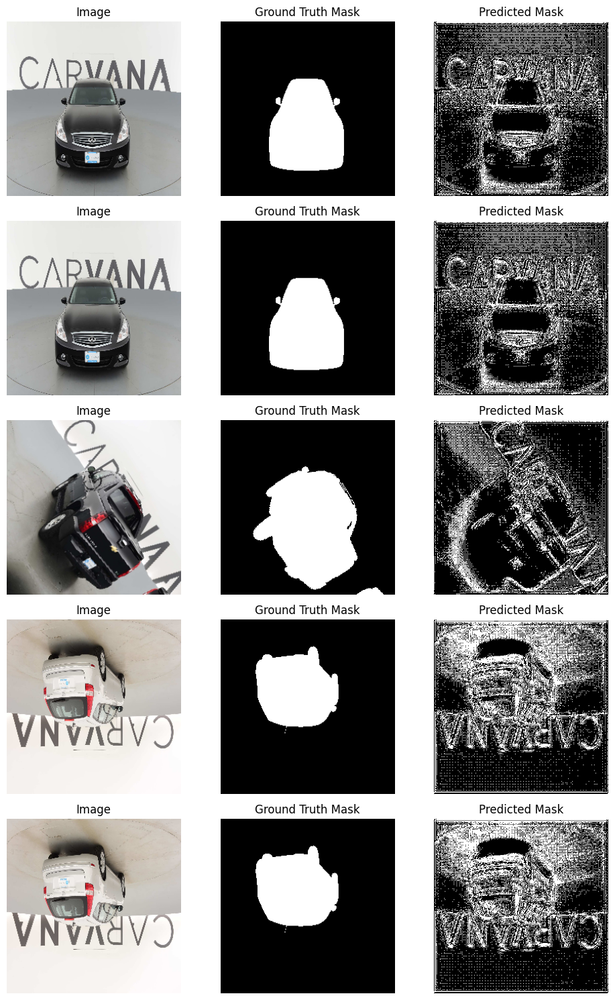

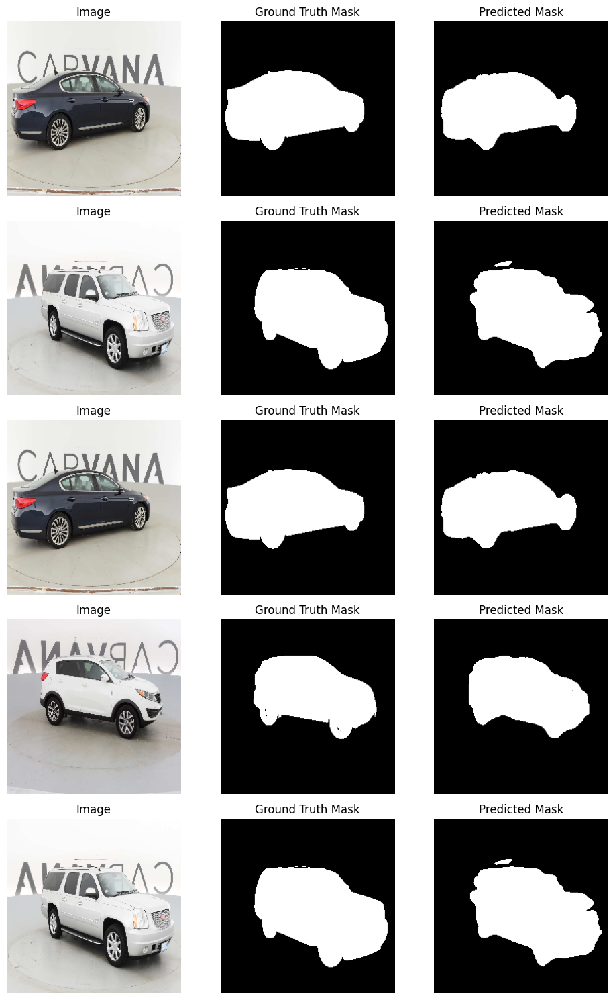

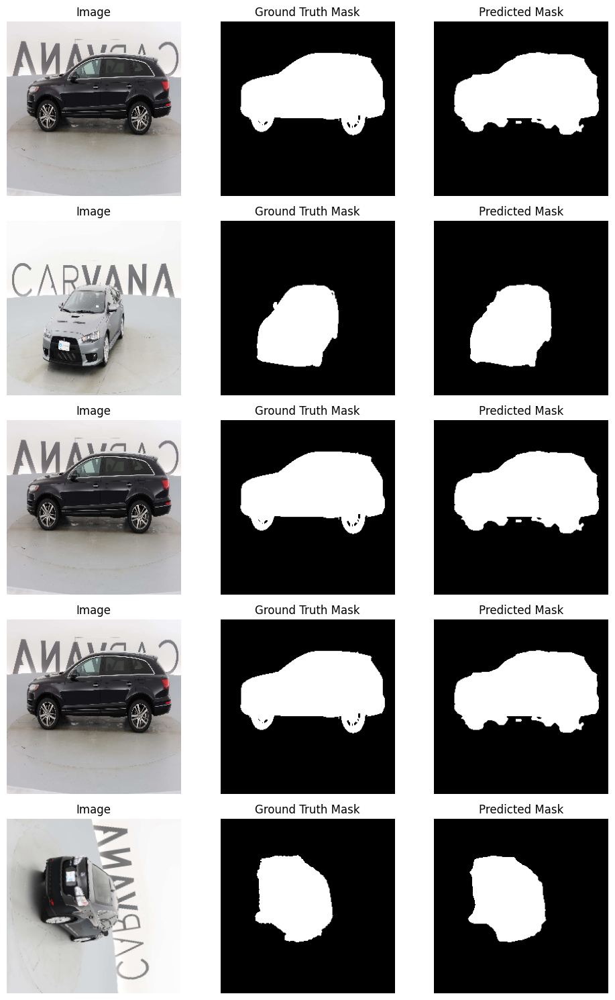

Epoch [1/15] Train Loss: 0.6293


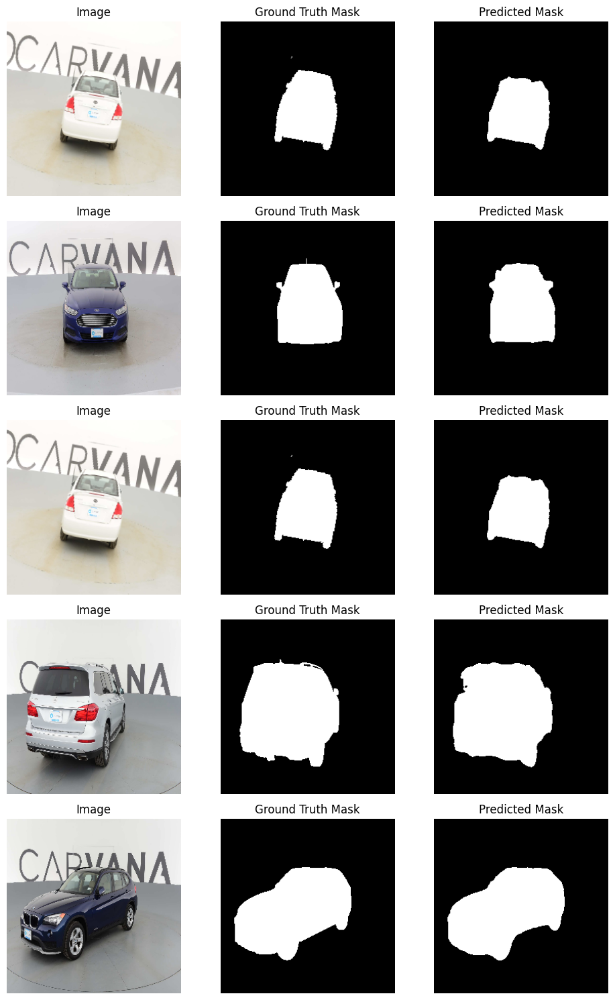

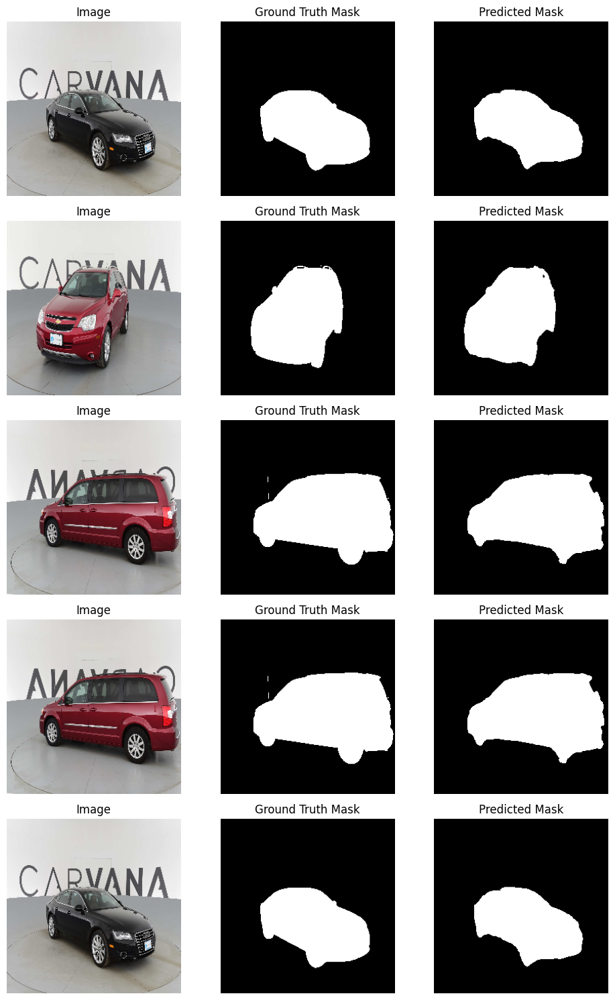

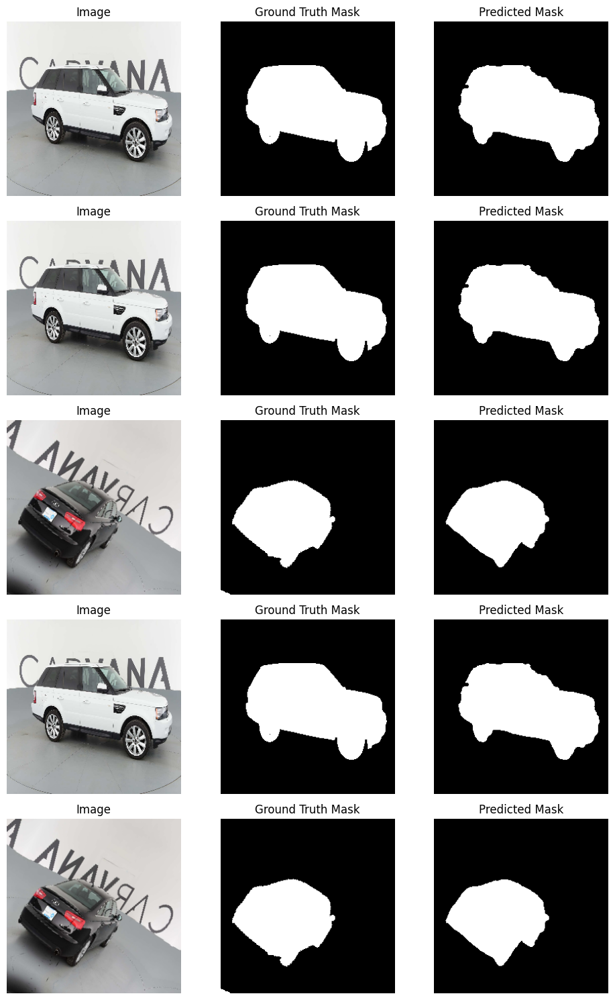

Epoch [2/15] Train Loss: 0.6182


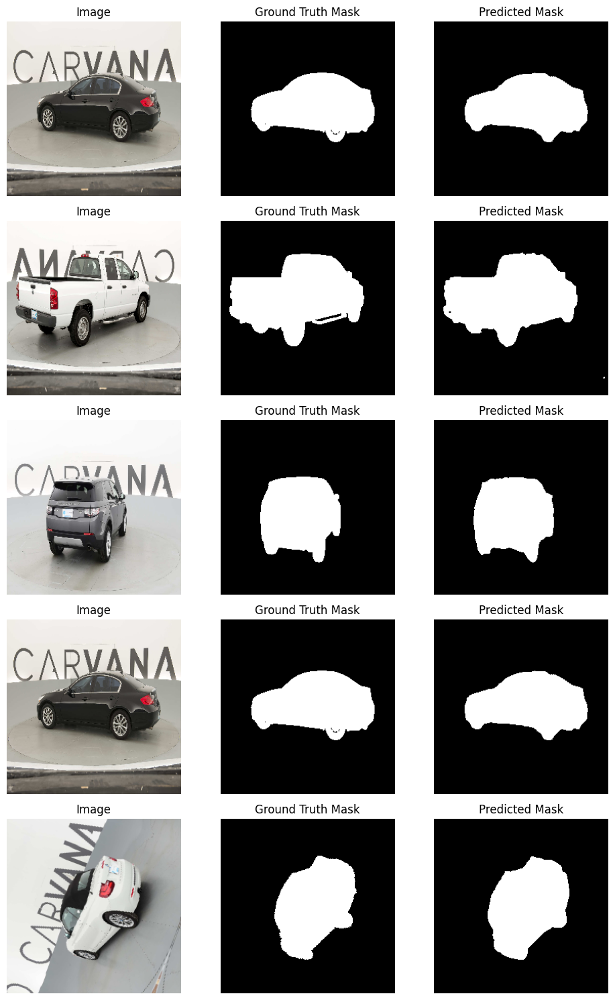

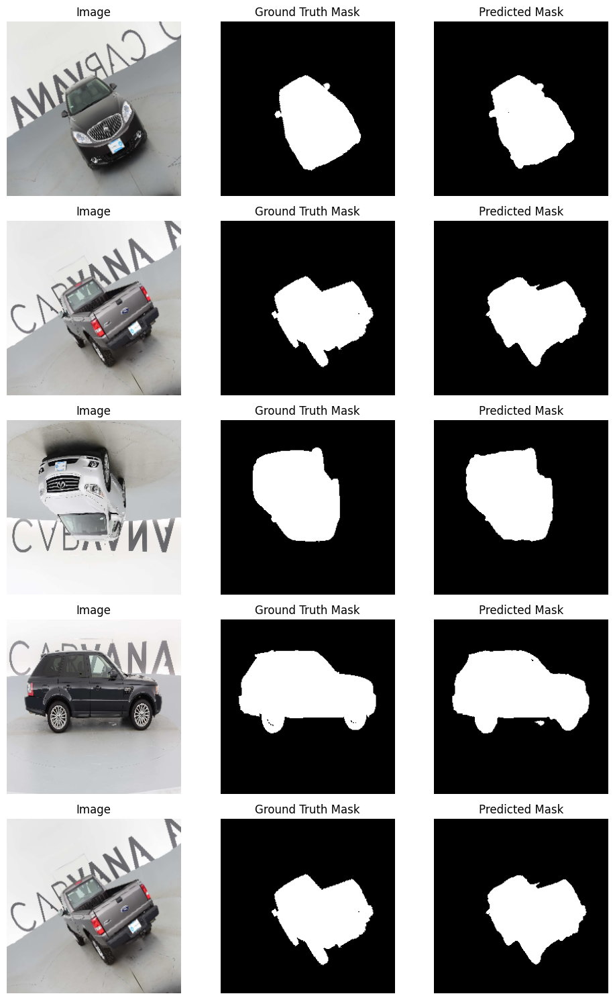

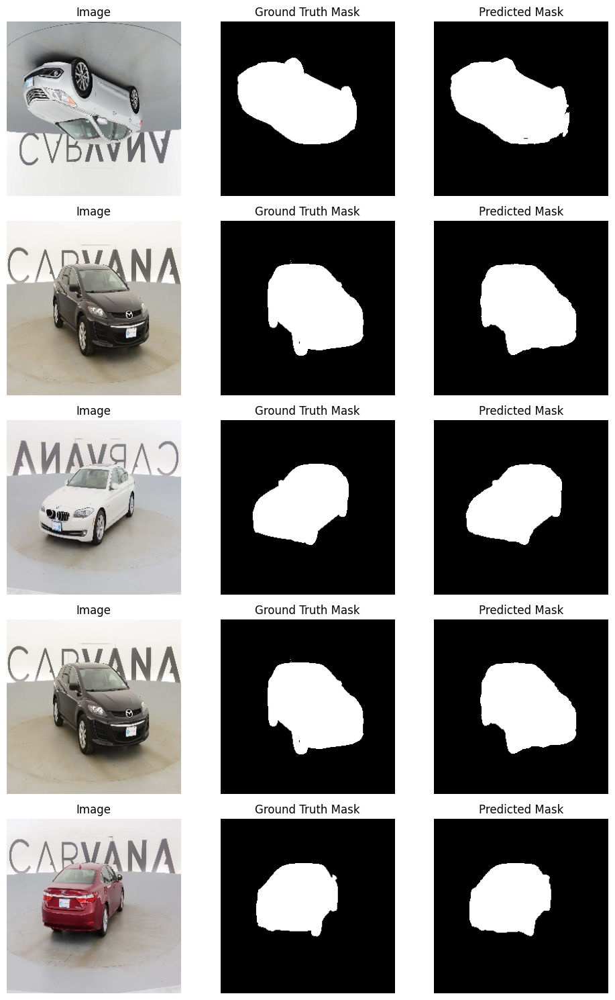

Epoch [3/15] Train Loss: 0.6168


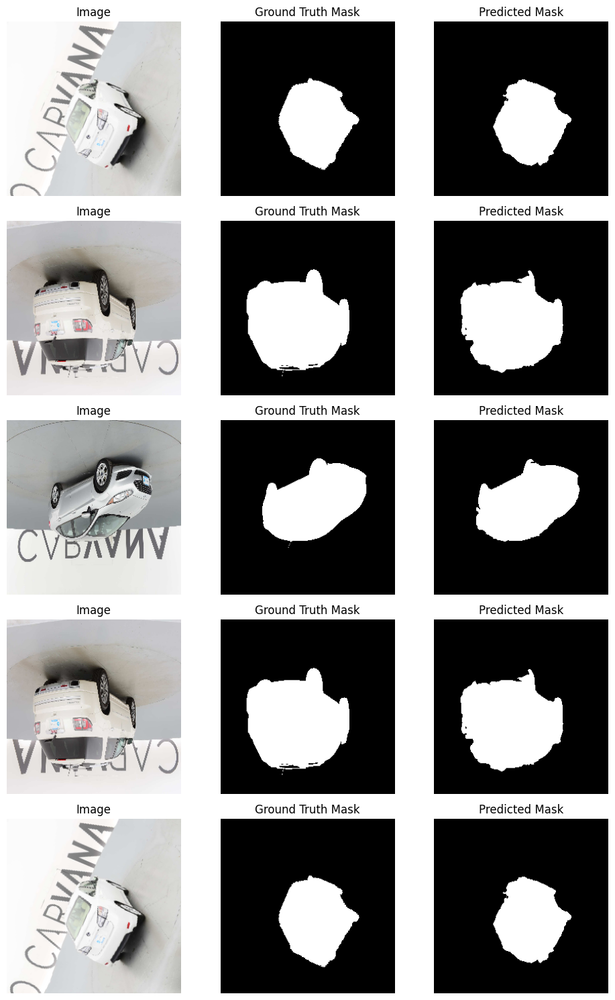

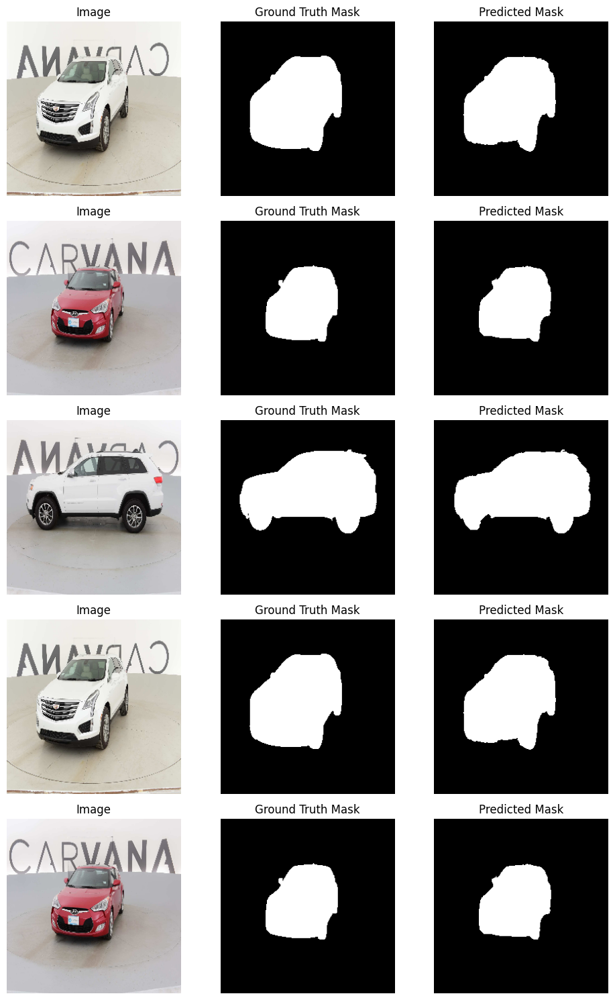

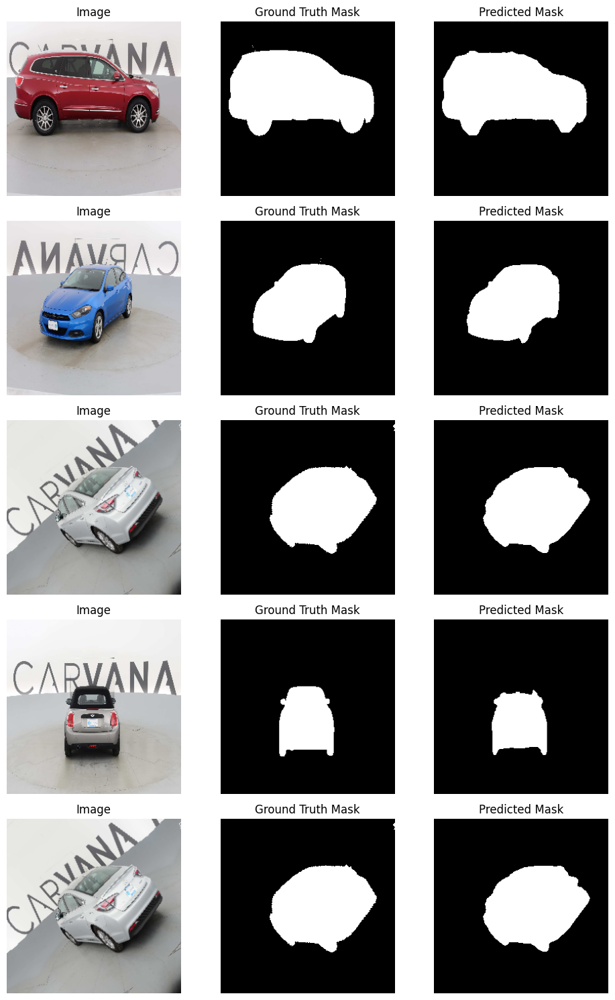

Epoch [4/15] Train Loss: 0.6164


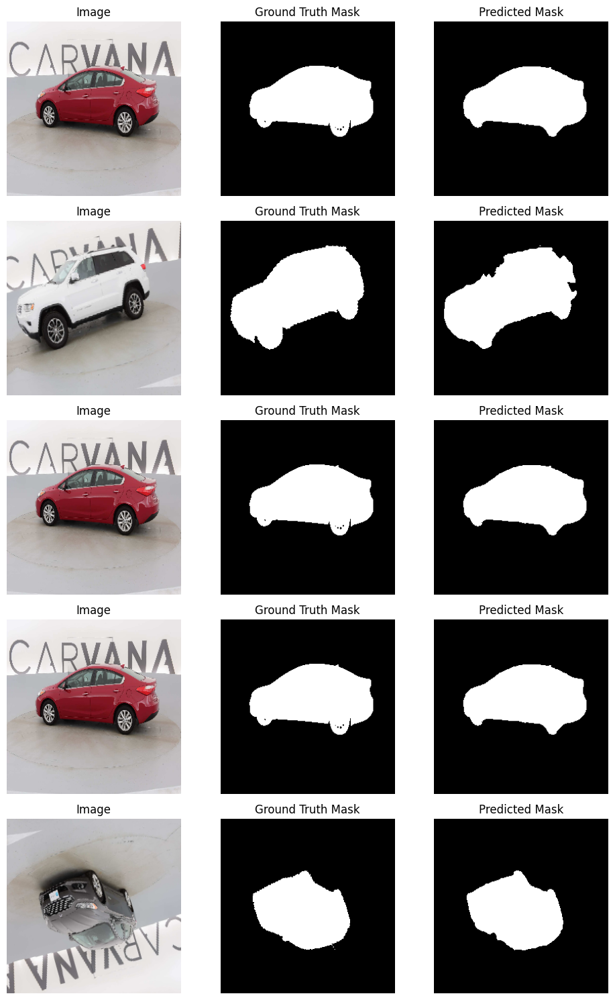

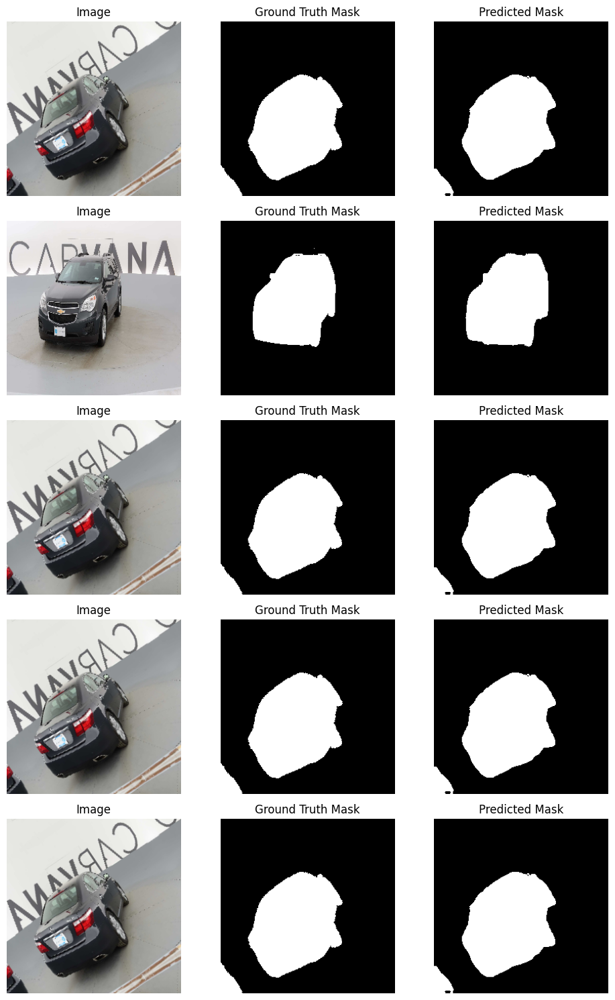

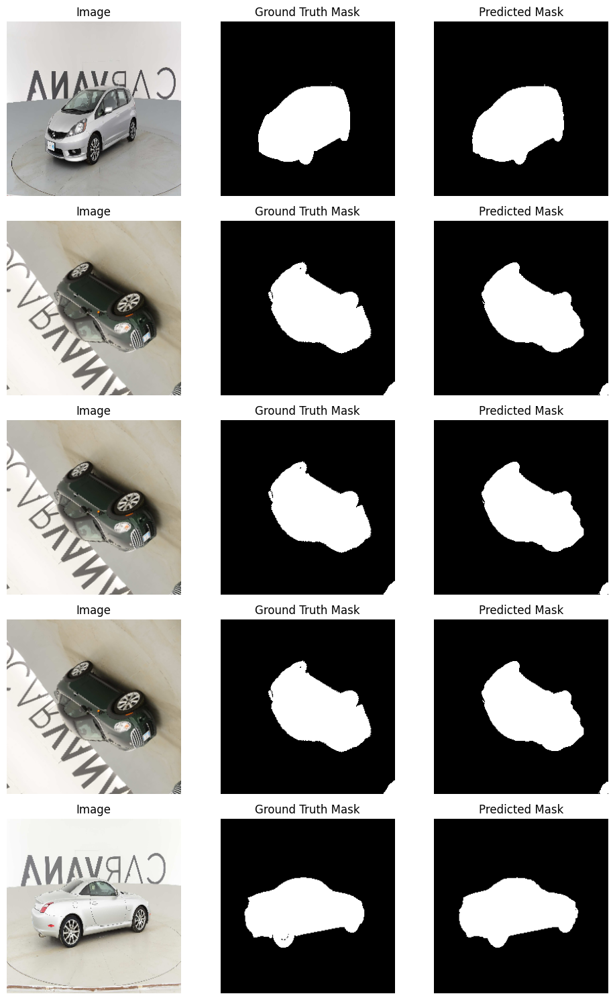

Epoch [5/15] Train Loss: 0.6162


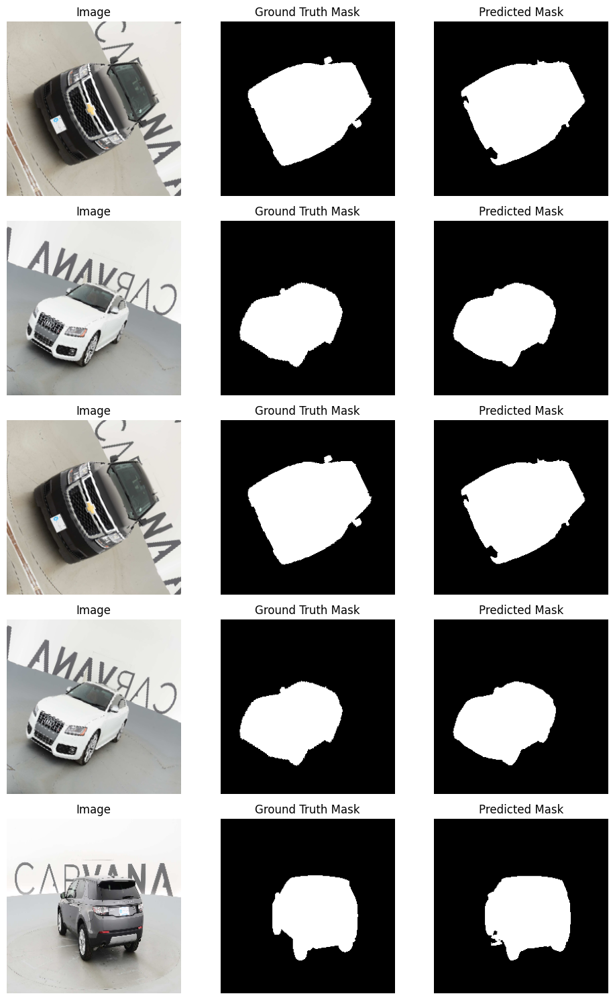

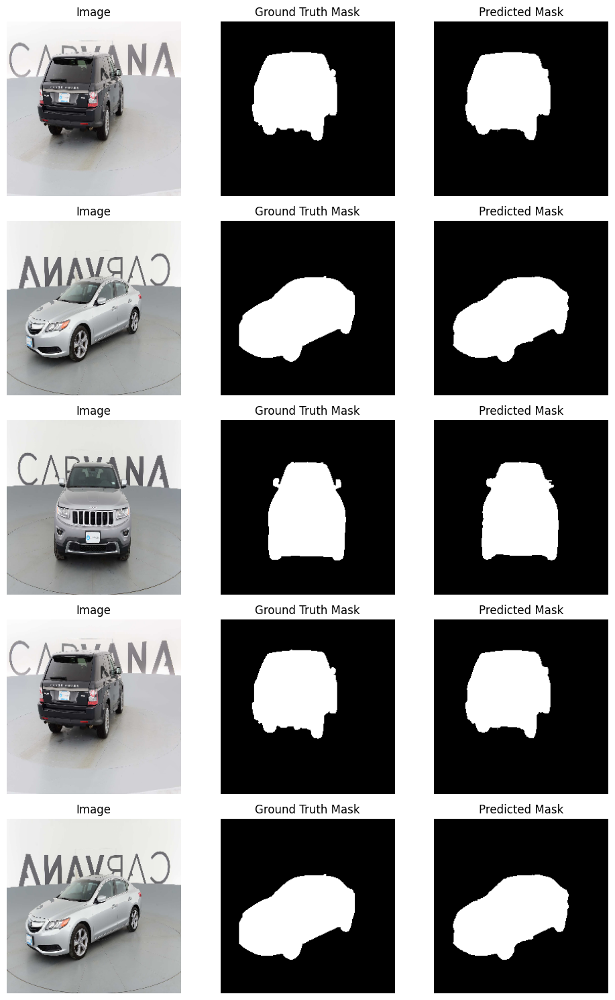

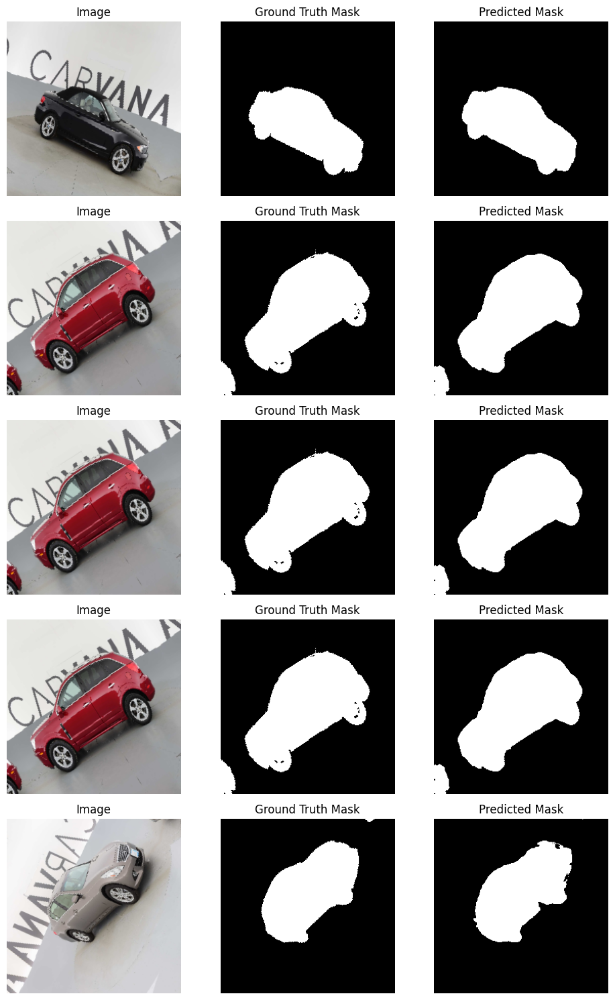

Epoch [6/15] Train Loss: 0.6158


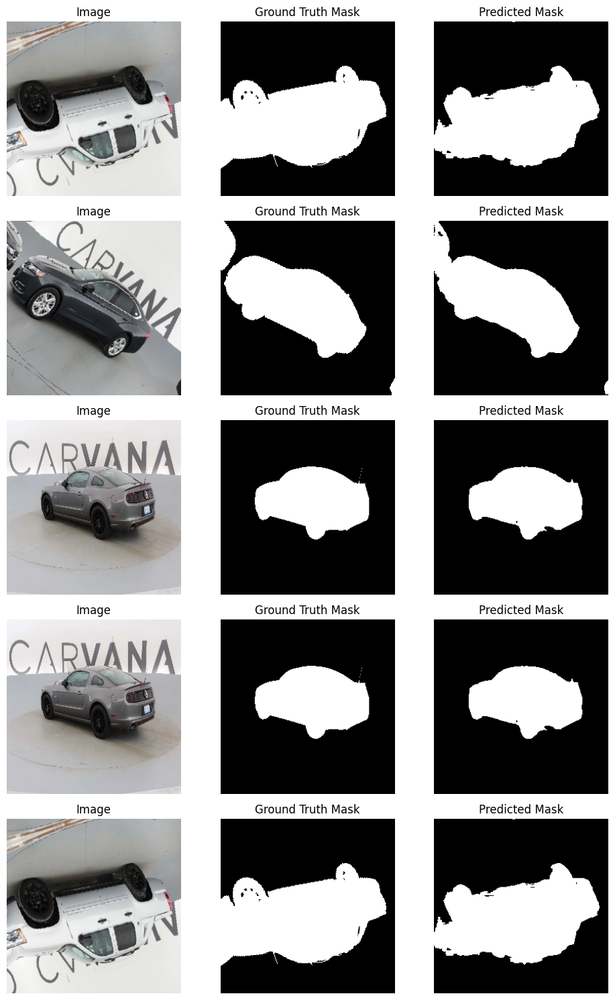

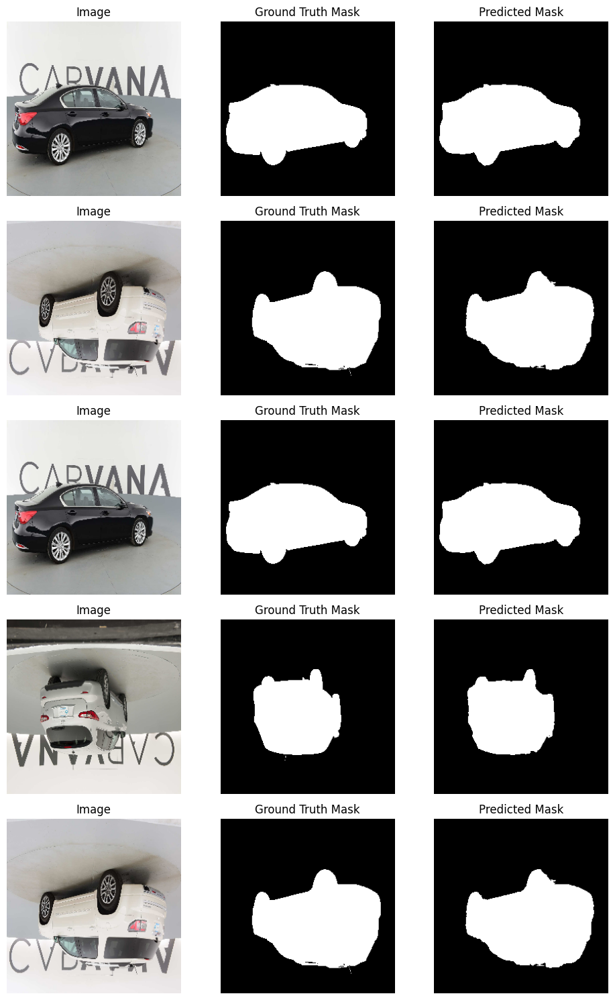

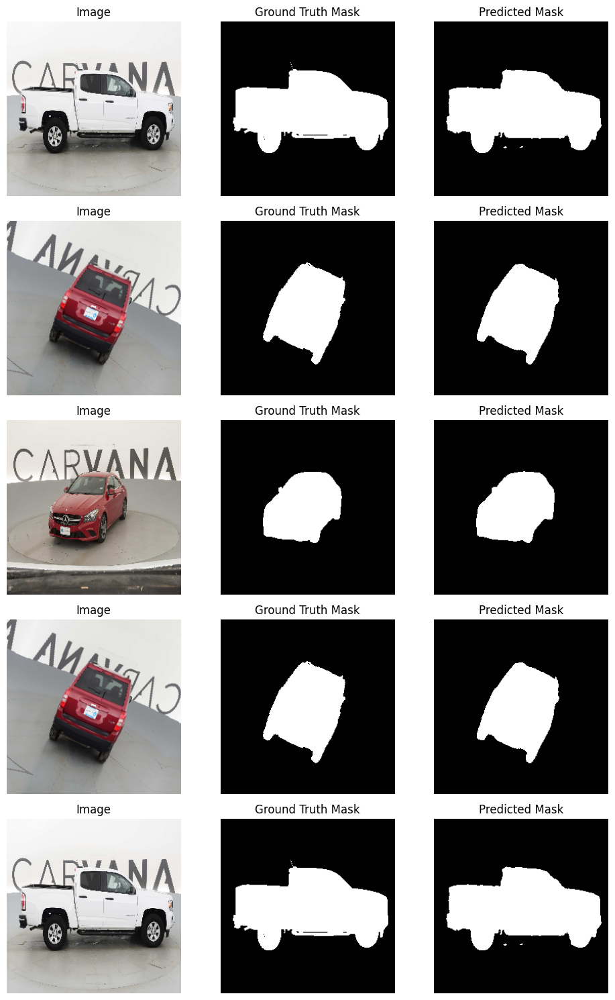

Epoch [7/15] Train Loss: 0.6157


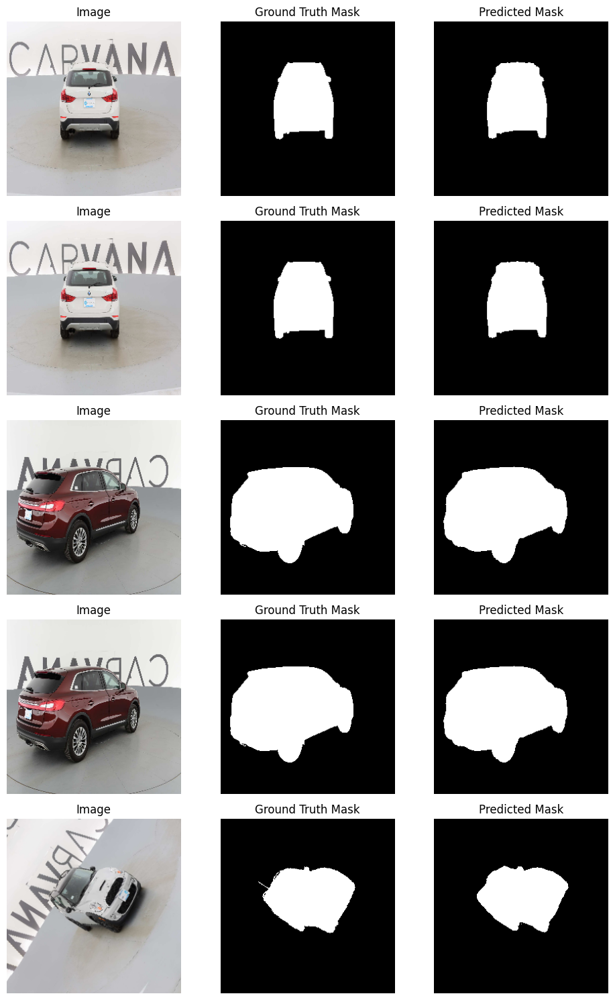

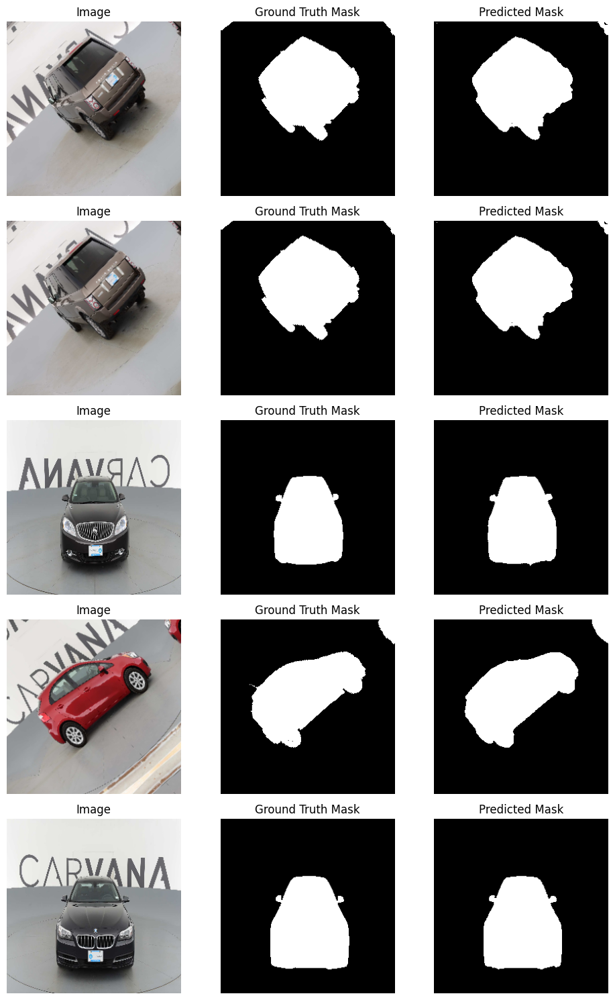

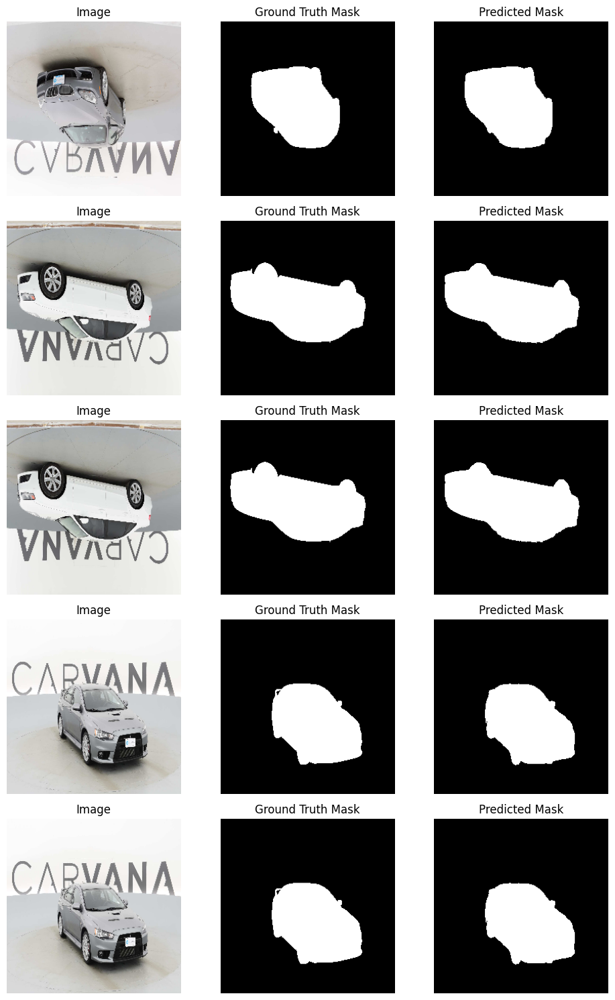

Epoch [8/15] Train Loss: 0.6154


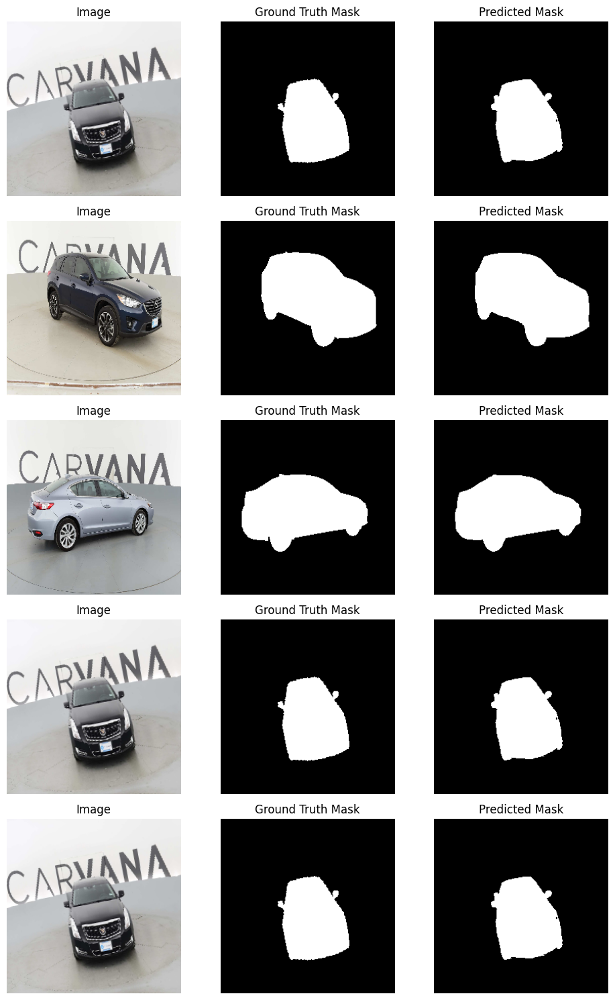

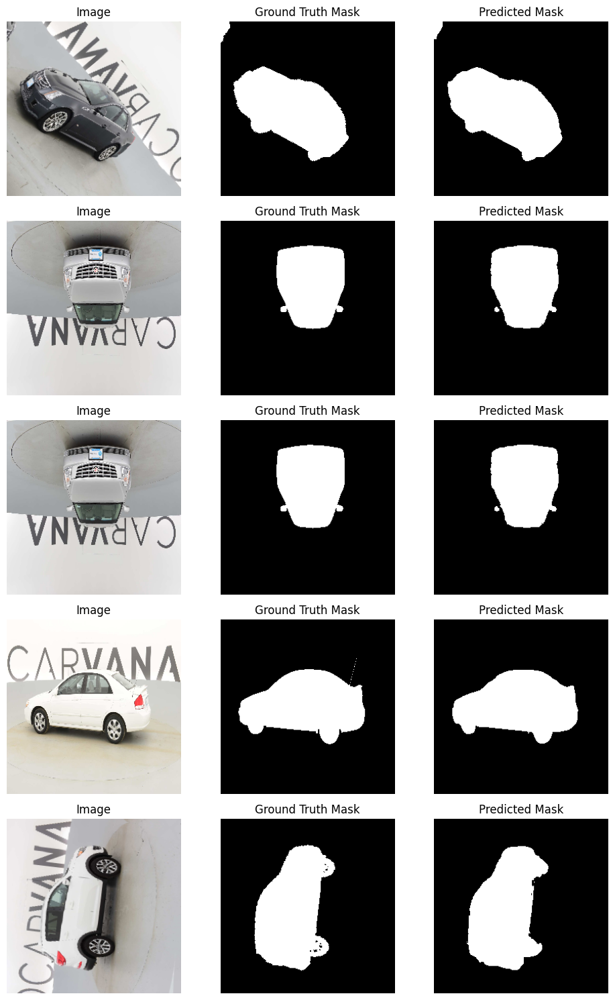

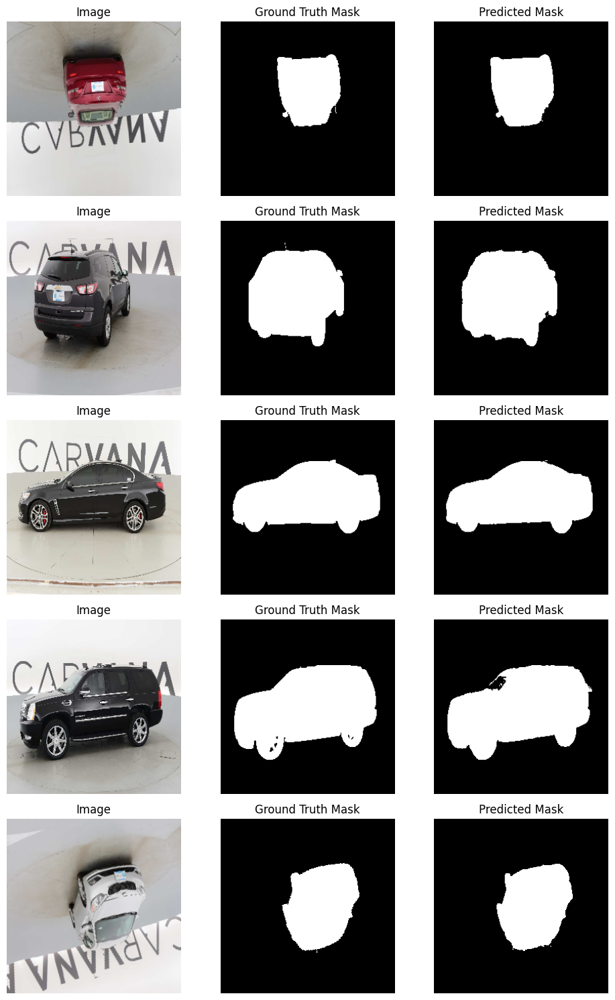

Epoch [9/15] Train Loss: 0.6155


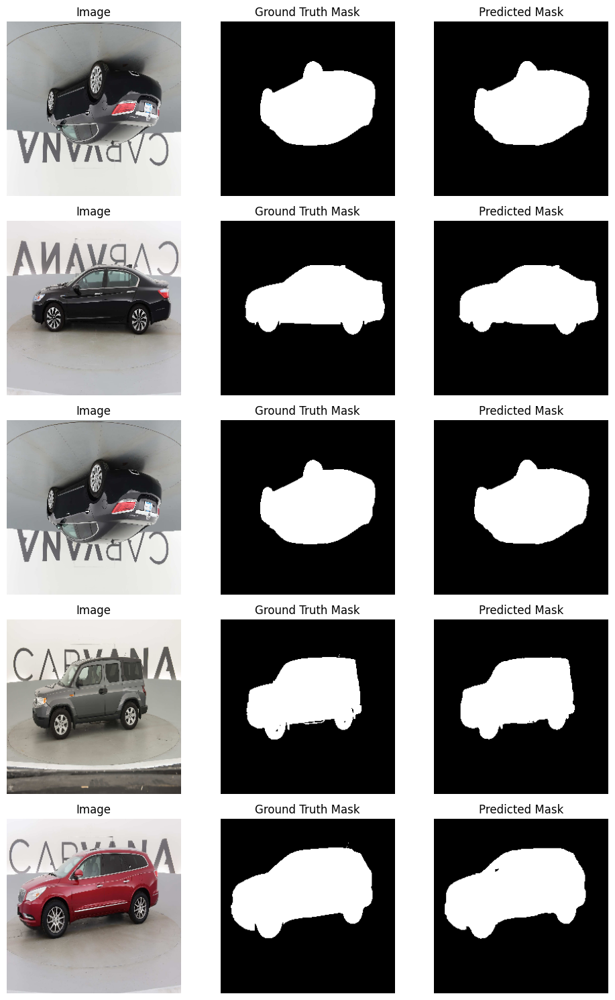

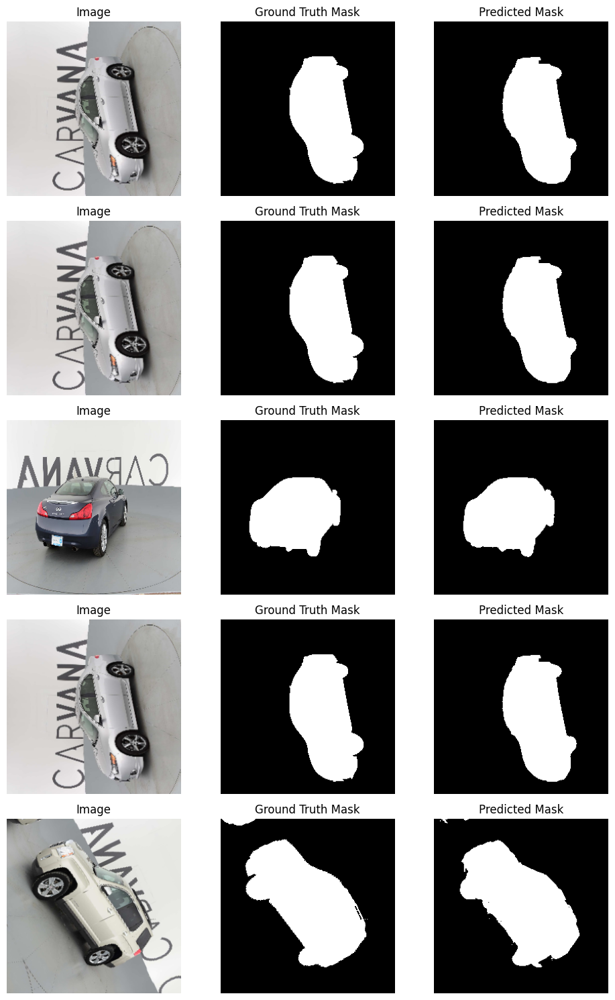

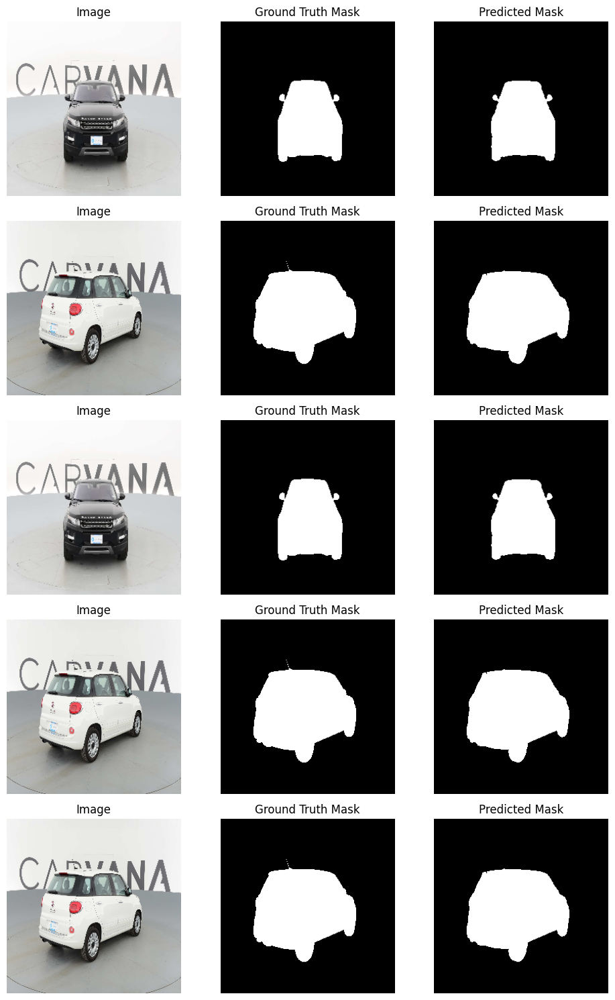

Epoch [10/15] Train Loss: 0.6151


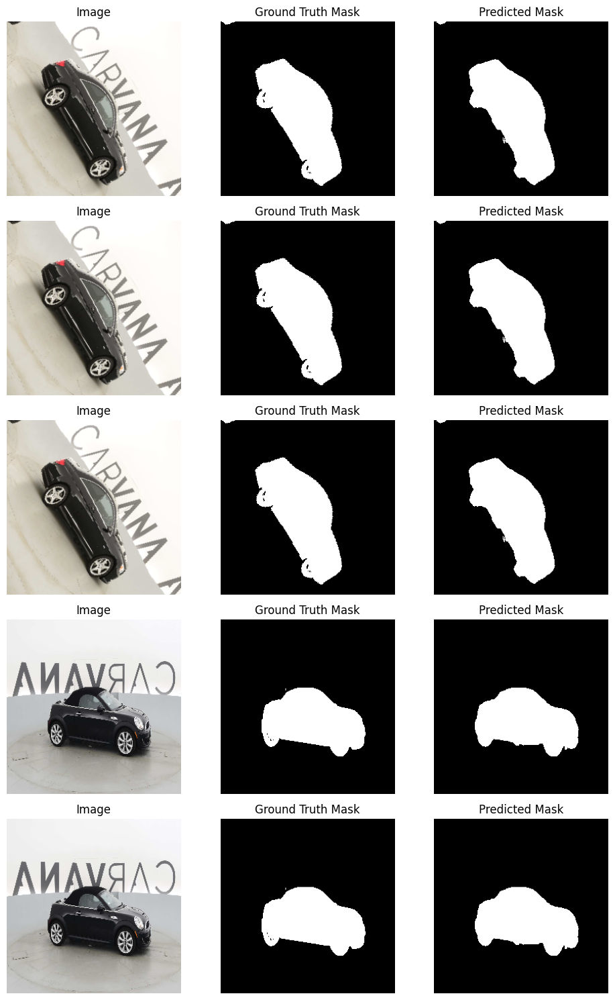

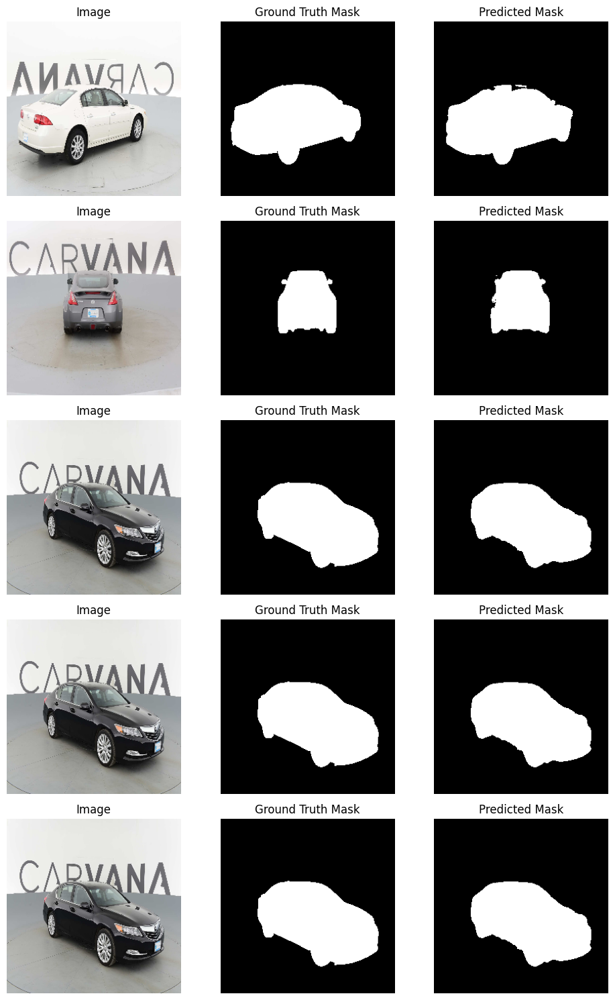

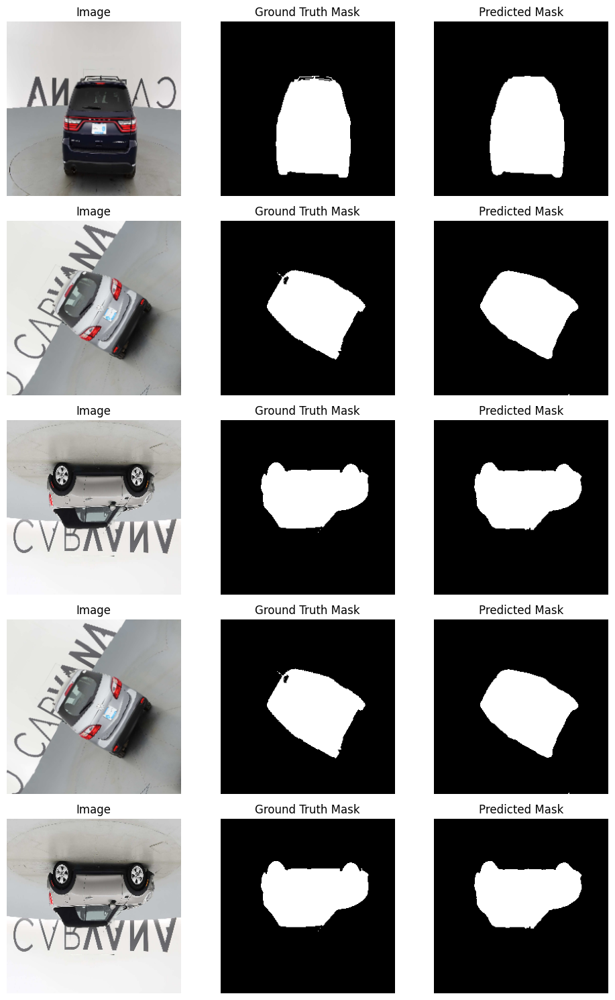

Epoch [11/15] Train Loss: 0.6153


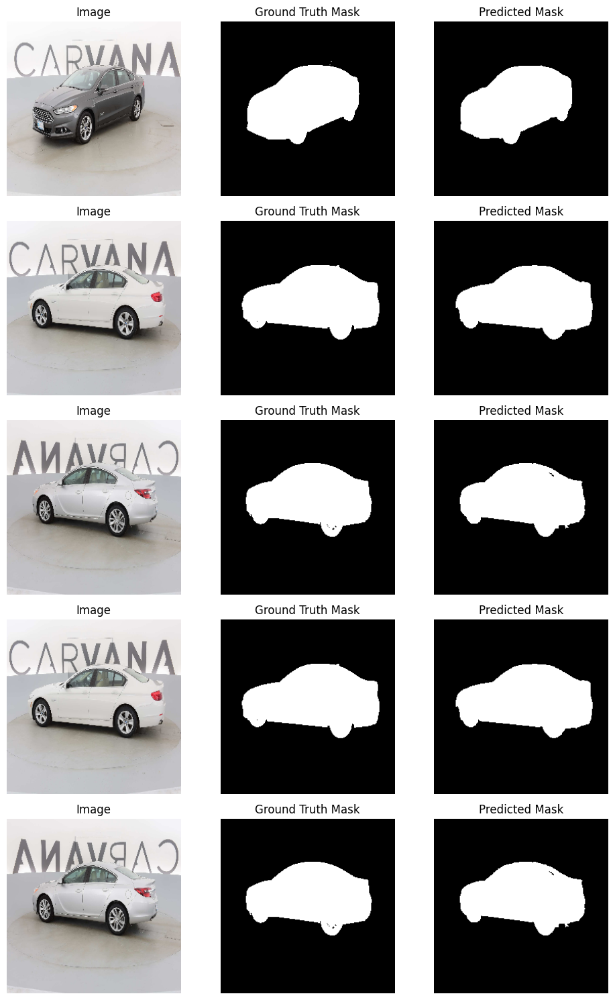

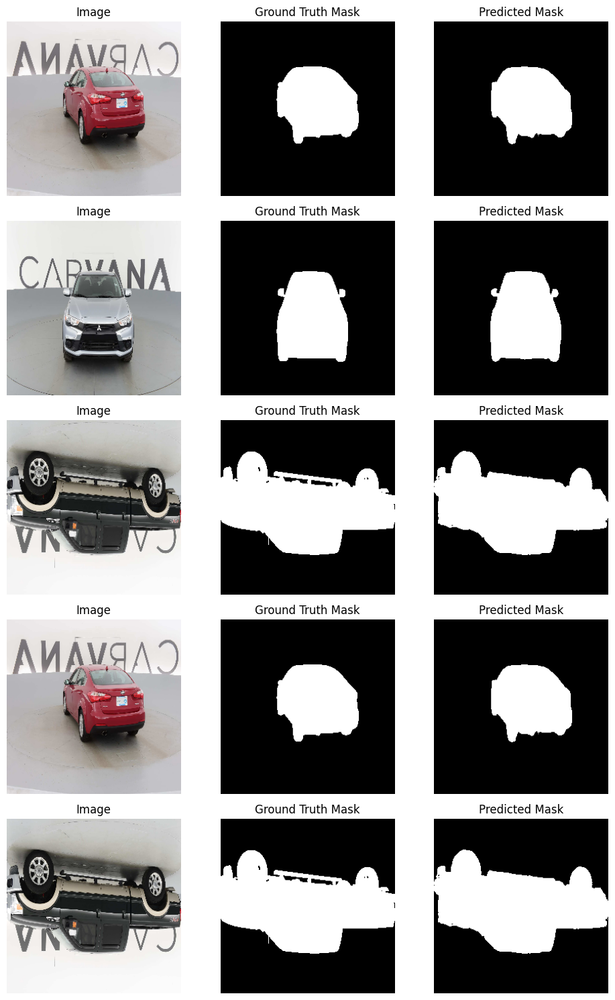

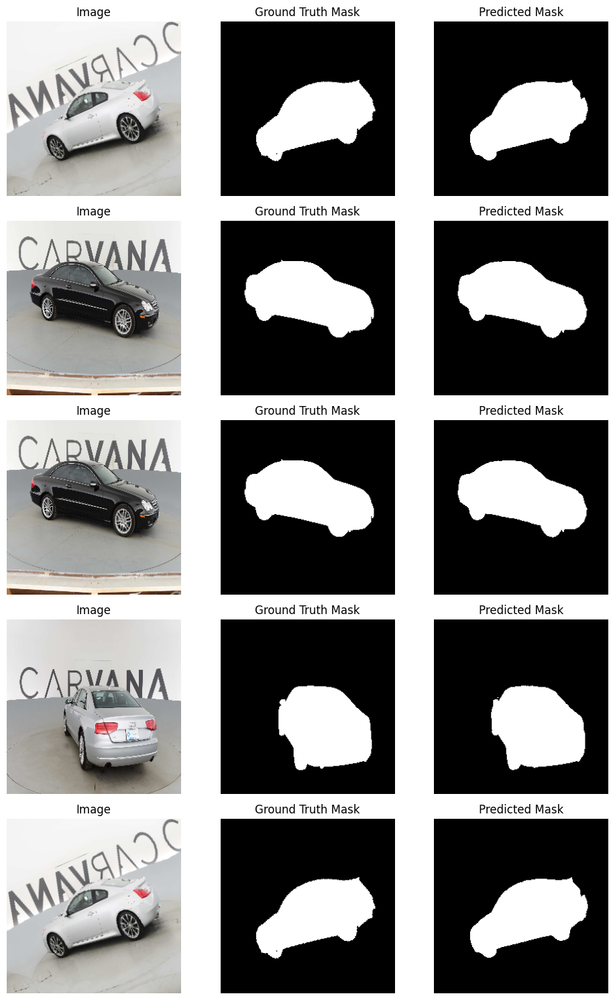

Epoch [12/15] Train Loss: 0.6151


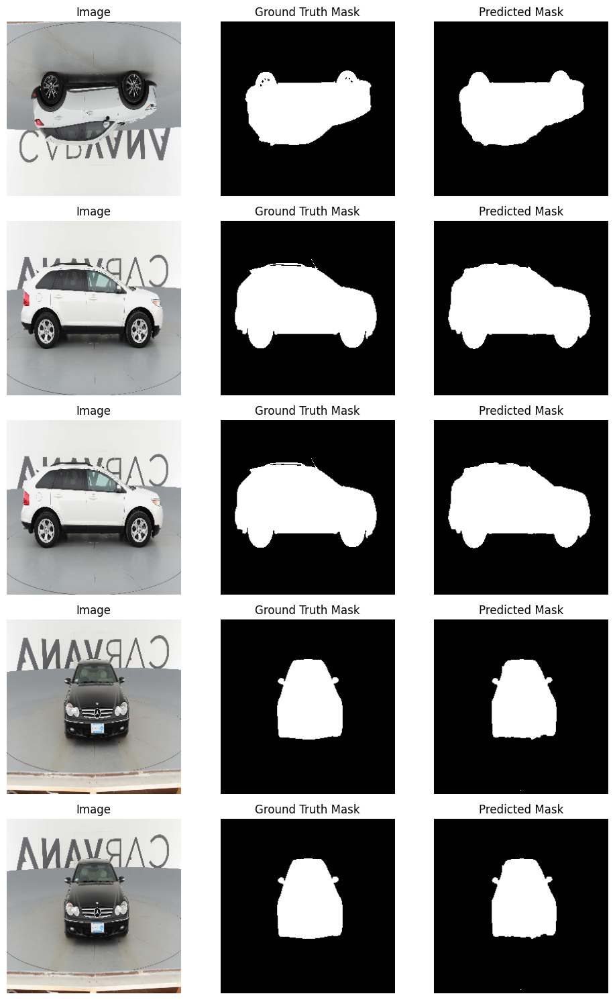

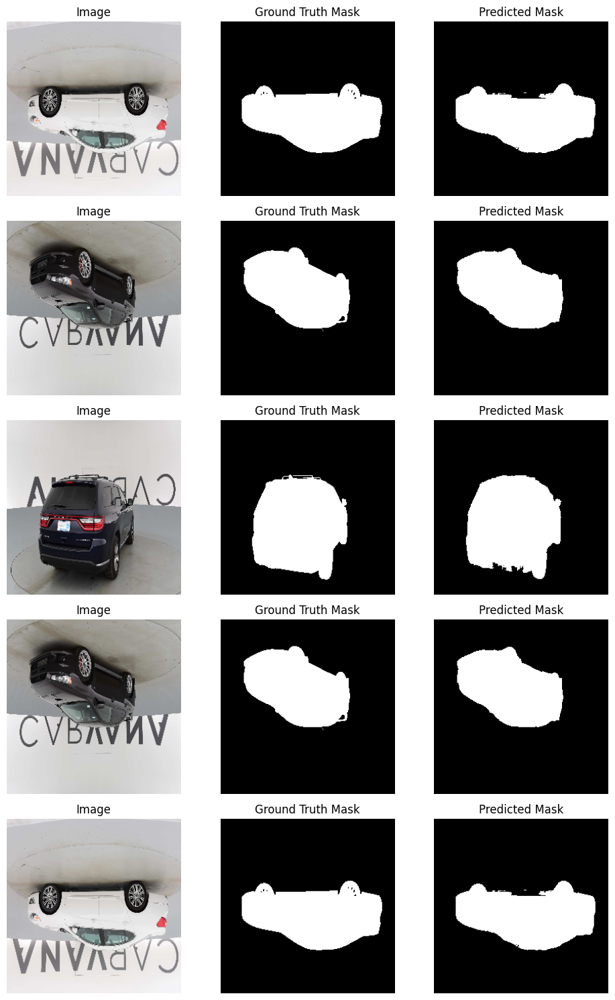

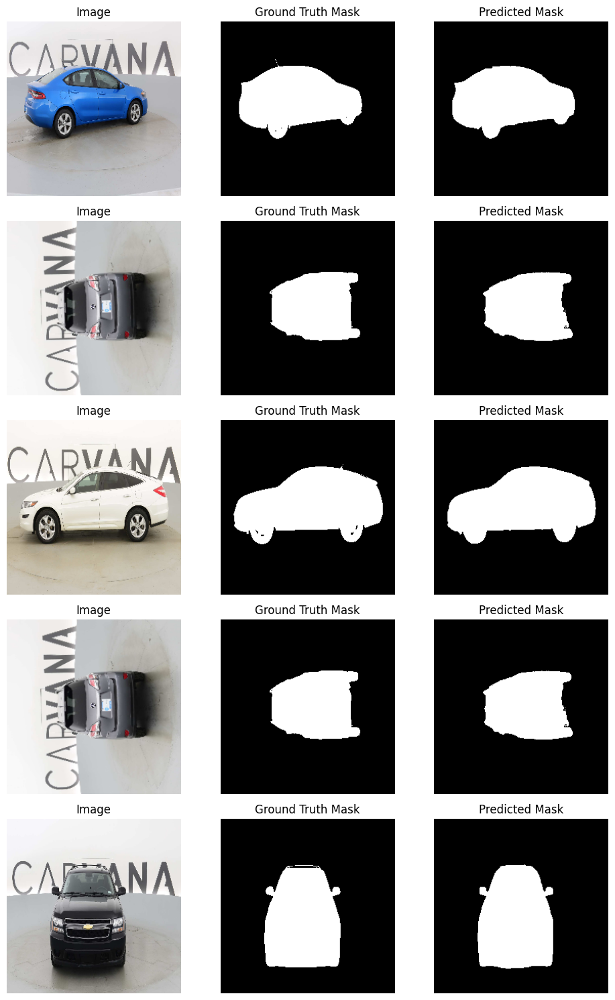

Epoch [13/15] Train Loss: 0.6150


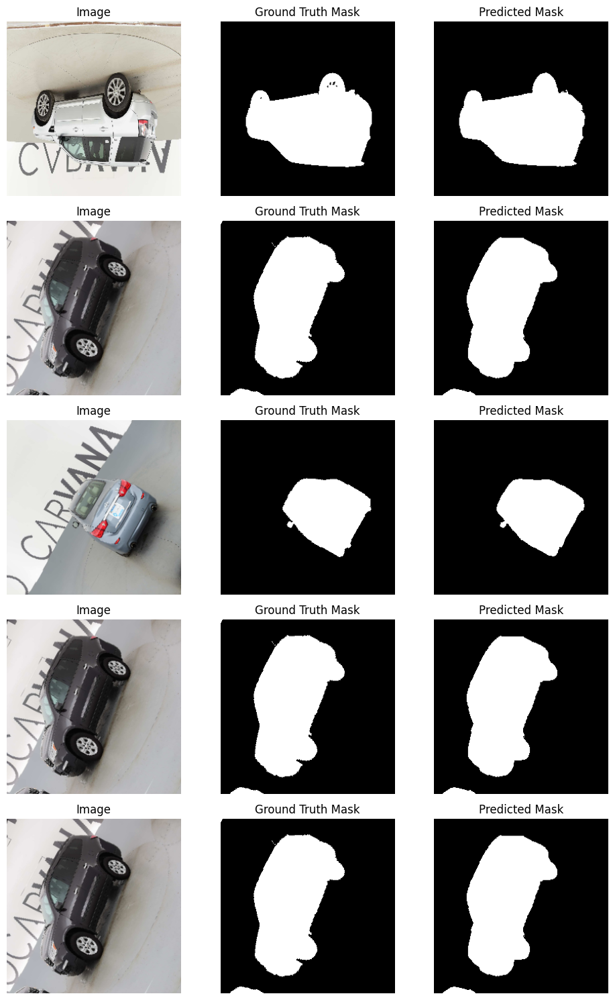

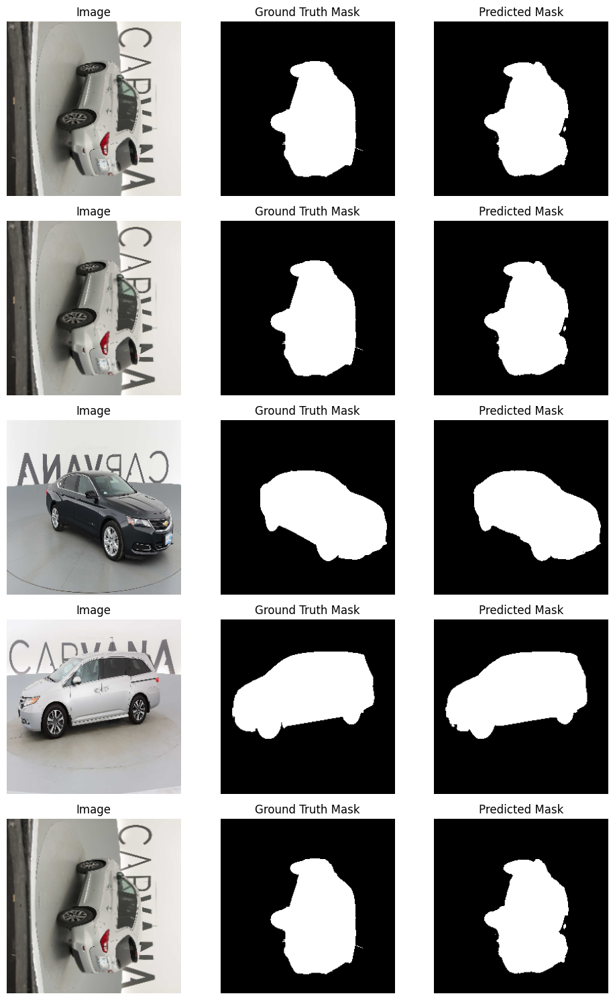

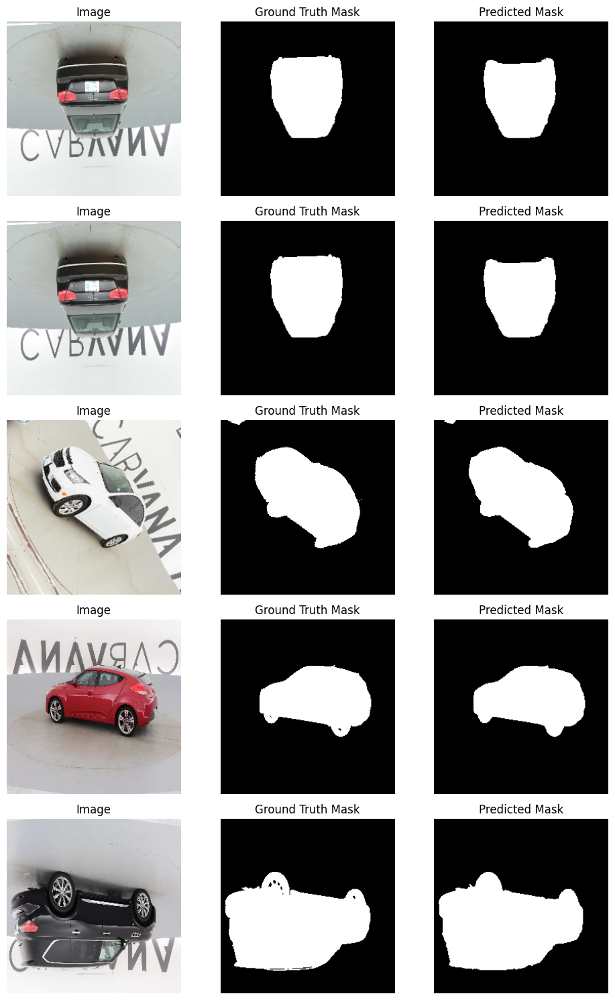

Epoch [14/15] Train Loss: 0.6152


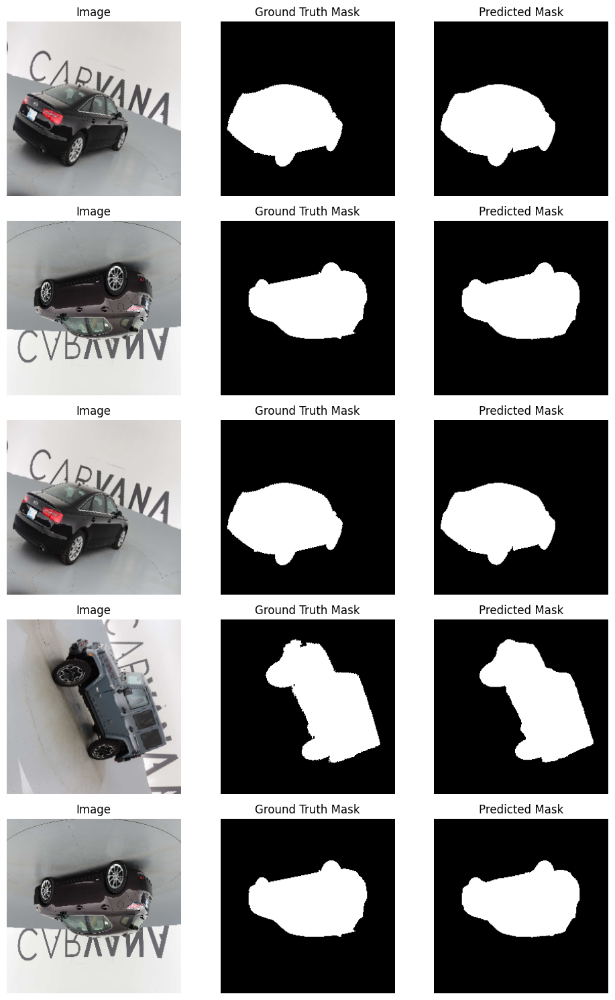

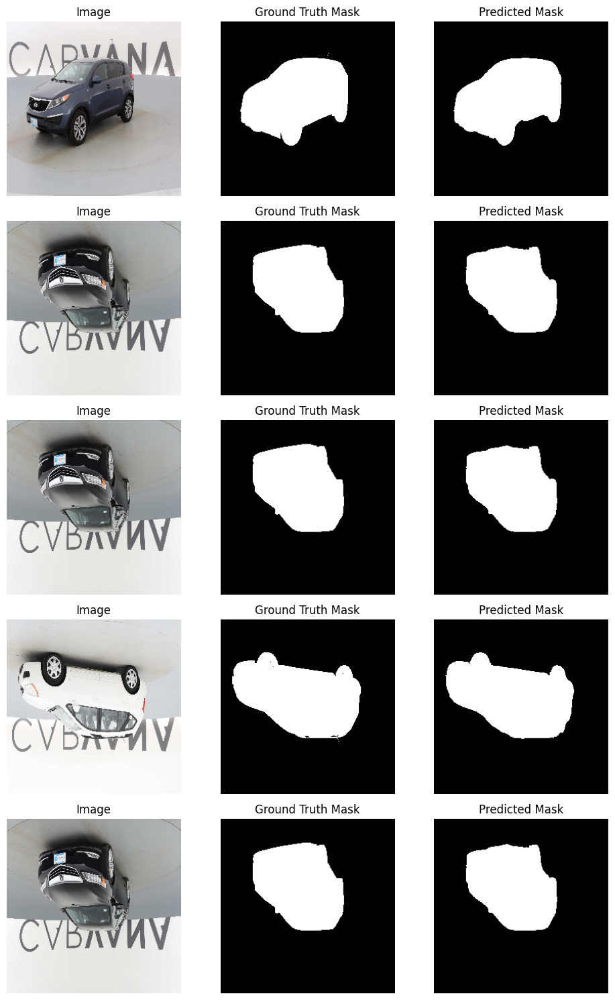

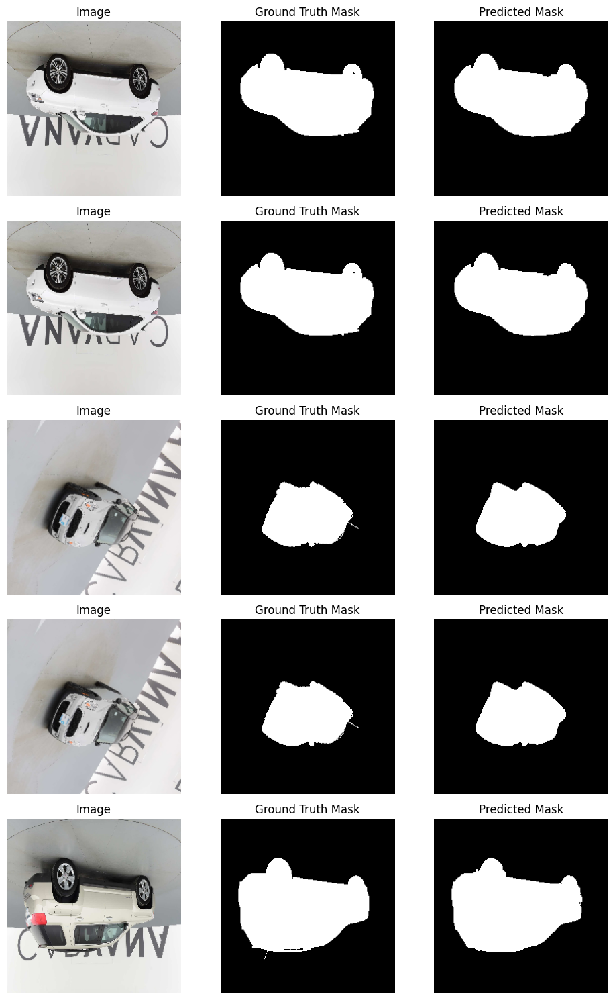

Epoch [15/15] Train Loss: 0.6149


In [15]:
# train loop
for epoch in range(n_epoch):
    model.train()
    train_loss = 0.0

    for batch_idx, (img, msk) in enumerate(dataloader):
        img, msk = img.to(torch.float32).to(device), msk.to(torch.float32).to(device)
        img = img.float() / 255.0
        optimizer.zero_grad()
        outputs = model(img)
        #msk = msk.float() / 256.0
        msk = msk.unsqueeze(1)
        #outputs = F.sigmoid(outputs.float())

        loss = criterion(outputs, msk)
        loss.backward()
        optimizer.step()

        train_loss += loss.item()
        
        image = img.cpu().numpy().transpose(0, 2, 3, 1)
        predicted_mask = outputs.cpu().detach().numpy()
        ground_truth_mask = msk.cpu().detach().numpy()

        predicted_mask = (predicted_mask > 0.5).astype(np.uint8)

        if batch_idx%500 == 0:
            visualize_images_with_masks(image, ground_truth_mask, predicted_mask, num_rows=5)

    train_loss /= len(dataloader)
    

    print(f"Epoch [{epoch+1}/{n_epoch}] Train Loss: {train_loss:.4f}")